# Loading the data

In [1]:
#imports and Drive mounting
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras

print(tf.__version__)

# Helper libraries
import numpy as np
import matplotlib.pyplot as plt
import sklearn as sk
import pandas as pd
from pandas import read_csv
from datetime import datetime
import math
import os

# fix random seed for reproducibility
seed = 2020
np.random.seed(seed)  

from sklearn.model_selection import train_test_split

from tensorflow.keras.datasets import cifar100
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, BatchNormalization, Activation
from tensorflow.keras.layers import Conv1D, MaxPooling1D, GlobalMaxPooling1D
from tensorflow.keras.layers import LSTM, GRU
from tensorflow.keras.regularizers import L1L2
from tensorflow.keras.constraints import max_norm
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras import optimizers

TensorFlow 2.x selected.
2.1.0


In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

!ls '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/'

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive
pollution_data.csv		 preprocessed_train_data_all.csv
preprocessed_pollution_data.csv  preprocessed_train_data.csv
preprocessed_test_data.csv	 preprocessed_val_data.csv


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f9020bb6dd8>,
      dtype=object)

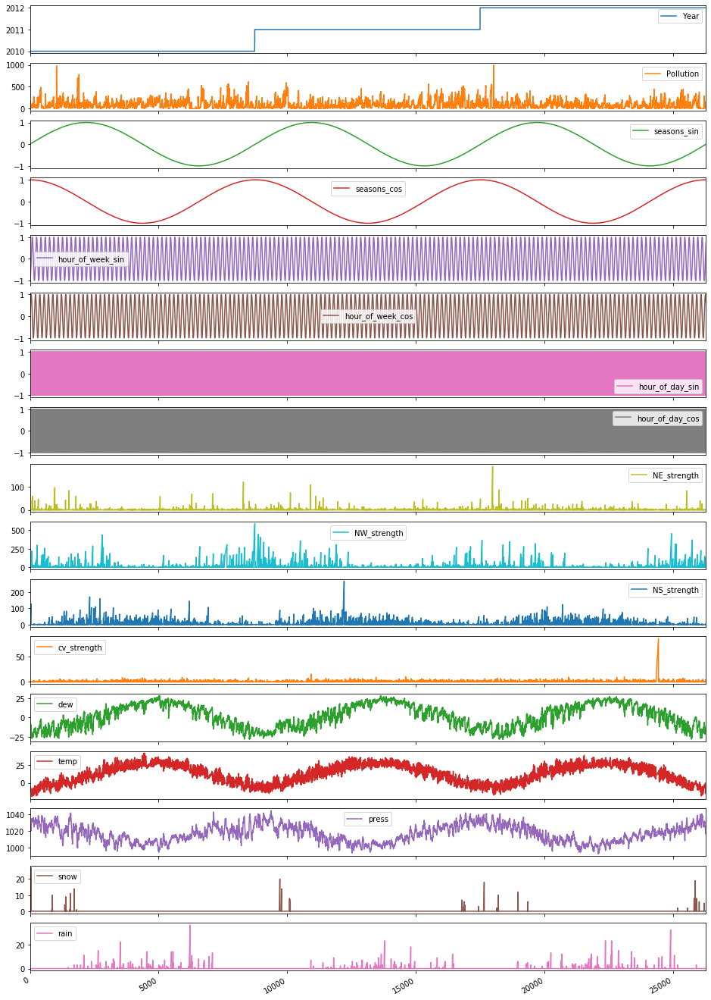

In [3]:
# load dataset

# this code only loads train and test datasets

# remember you also need to split off a validation dataset
# either by reusing and adapting the splitting code from the preprocessing notebook 
# or by writing your own code
# like in the previous assignments, this means you should have 4 sets:

# train_all (train+validate), train, validate and test

# The PATH setting below assumes you just uploaded the data file to your Colab session
# When using Drive: replace this by the path where you put the data file
DATAPATH = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/'
TRAINDATAALLFILE = DATAPATH+'preprocessed_train_data_all.csv'
TRAINDATAFILE = DATAPATH+'preprocessed_train_data.csv'
VALDATAFILE = DATAPATH+'preprocessed_val_data.csv'
TESTDATAFILE = DATAPATH+'preprocessed_test_data.csv'

train_all_dataset = read_csv(TRAINDATAALLFILE, header=0, index_col=0)
train_dataset = read_csv(TRAINDATAFILE, header=0, index_col=0)
val_dataset = read_csv(VALDATAFILE, header=0, index_col=0)
test_dataset = read_csv(TESTDATAFILE, header=0, index_col=0)

#check - note that you can make many other plots directly from pandas dataframes:
# https://pandas.pydata.org/pandas-docs/version/0.16/visualization.html
train_dataset.plot(subplots=True,figsize=(16,26))

## Extract train, validate and test features and labels

In the code below, we will split of an arbitrary number of 5000 samples at the end of the training set as validation data. It is up to you to decide how much data you split off.# New Section

In [4]:
# extract data from dataframes, selecting the features you want
# note that the labels simply contain the pollution data for now
# depending on the window sizes used in training, the correct values will be cut out
features = np.arange(1,17)
pollution = 1

# Important: Tensorflow 2.x gives an error if you omit
# the np.asarray(...,,dtype=np.float32)
train_all_values = np.asarray(train_all_dataset.values[:,features],dtype=np.float32)
train_all_labels = np.asarray(train_all_dataset.values[:,pollution],dtype=np.float32)
train_values = np.asarray(train_dataset.values[:,features],dtype=np.float32)
train_labels = np.asarray(train_dataset.values[:,pollution],dtype=np.float32)
val_values = np.asarray(val_dataset.values[:,features],dtype=np.float32)
val_labels = np.asarray(val_dataset.values[:,pollution],dtype=np.float32)
test_values = np.asarray(test_dataset.values[:,features],dtype=np.float32)
test_labels = np.asarray(test_dataset.values[:,pollution],dtype=np.float32)

print(train_all_values.shape)
print(train_all_labels.shape)
print(train_values.shape)
print(train_labels.shape)
print(val_values.shape)
print(val_labels.shape)
print(test_values.shape)
print(test_labels.shape)

(35040, 16)
(35040,)
(26280, 16)
(26280,)
(8760, 16)
(8760,)
(8760, 16)
(8760,)


## Normalising the data

As you know by now, it is important to normalise the data. The flow is the following:

- initialise normaliser 1
- fit on training date
- use it to transform train and validation data

For your final model(s) you need a second normaliser:
- initialise normaliser 2
- fit on training+validation data
- use it to transform training+validation and test data

This has to be done **before** reformatting the data into windows (next section). 

Although we already did this before, the code below gives an example (adapt the code after you've defined a validation set:

In [5]:
# imports to show that there are many different scalers
# especially with recurrent NNs, the choice of scaler can make a difference
# look up what they do before choosing which one to try
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer # BAD for this case
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PowerTransformer # BEST for this case

# Example: train standard scalers, apply to train and test data
# adapt to do all you need to do ...
SS1 = PowerTransformer()
SS1.fit(train_values)

train_scaled = SS1.transform(train_values)
train_scaled[:,14] /= 5.0
train_scaled[:,15] /= 2.0
val_scaled = SS1.transform(val_values)
val_scaled[:,14] /= 5.0
val_scaled[:,15] /= 2.0

SS2 = PowerTransformer()
SS2.fit(train_all_values)

train_all_scaled = SS2.transform(train_all_values)
test_scaled = SS2.transform(test_values)

/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


In [6]:
# dense network:
# here you only need to take into account that we are predicting 6 steps ahead
# this means that the features of the first timestep (index 0)
# are used to predict the 7th pollution value (index 6) so the first 6 and the last 6 feature-samples labels are omitted

def create_dataset_dense(train, test, ahead=6):   # can use this with different 'ahead' values, but default is set to 6
    return train[:-ahead,:], test[ahead:]

X_train_d,r_train_d = create_dataset_dense(train_scaled,train_labels)
X_val_d,r_val_d = create_dataset_dense(val_scaled,val_labels)

X_train_all_d,r_train_all_d = create_dataset_dense(train_all_scaled,train_all_labels)
X_test_d,r_test_d = create_dataset_dense(test_scaled,test_labels)

print(X_train_d.shape)
print(r_train_d.shape)

(26274, 16)
(26274,)


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f901f4e6278>,
      dtype=object)

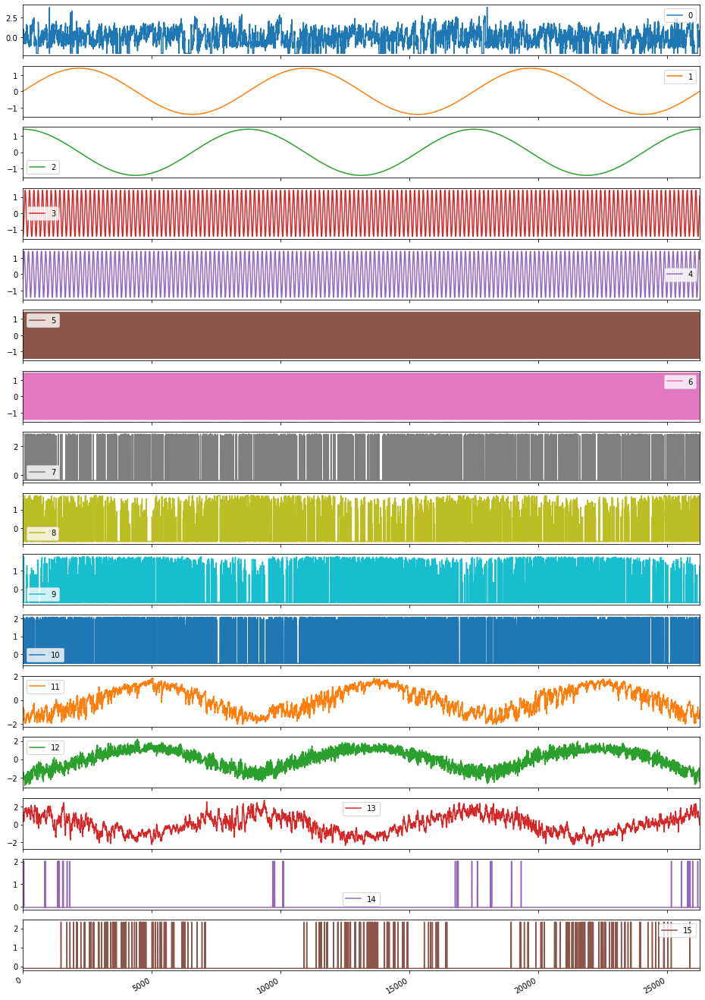

In [7]:
pd.DataFrame(train_scaled).plot(subplots=True,figsize=(16,26))

# Step 1

In [8]:
# Train a Dense network on the scaled features
from tensorflow.keras import Input
from tensorflow.keras.models import Model
from tensorflow.keras.constraints import MaxNorm

batch_size = 1024
learning_rate = 0.001
epochs = 30
cols = train_scaled.shape[1]


def dense_model(num_features,learning_rate=0.01,hidden=[16,32],ridge_param = 0.00001,dropouts=[0.1,0.2]):
  # create linear model
  model = Sequential()
  model.add(Dropout(0.001, input_shape=(cols,)))
  for idx in range(len(hidden)):
    model.add(Dense(hidden[idx],activation = 'relu',kernel_regularizer=tf.keras.regularizers.l2(ridge_param),kernel_initializer='he_uniform'))
    model.add(Dropout(dropouts[idx]))
  model.add(Dense(1,activation='linear',kernel_regularizer=tf.keras.regularizers.l2(ridge_param),kernel_initializer='he_uniform'))
  
  #optim = tf.keras.optimizers.Adam(lr=learning_rate)
  optim = tf.keras.optimizers.RMSprop(learning_rate)
  # Compile model
  model.compile(loss='mae', optimizer=optim, metrics=['mae']) # keep extra metrics: mse and mae without regularisation terms
  return model

model = dense_model(num_features=cols)
model.summary()
linreg_history = model.fit(x=X_train_d,y=r_train_d,
          batch_size=batch_size, epochs=epochs,
          validation_data=(X_val_d,r_val_d),shuffle=True)


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dropout (Dropout)            (None, 16)                0         
_________________________________________________________________
dense (Dense)                (None, 16)                272       
_________________________________________________________________
dropout_1 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                544       
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 33        
Total params: 849
Trainable params: 849
Non-trainable params: 0
__________________________________________________________

In [9]:
!pip install lime

     |████████████████████████████████| 276kB 13.4MB/s 
  Created wheel for lime: filename=lime-0.1.1.37-cp36-none-any.whl size=284277 sha256=ea9eeb4c0e84da92e5ffc0e04000ccb784ff335b18c369d9eee1d5153132ca1c
  Stored in directory: /root/.cache/pip/wheels/c1/38/e7/50d75d4fb75afa604570dc42f20c5c5f5ab26d3fbe8d6ef27b
  Created wheel for progressbar: filename=progressbar-2.5-cp36-none-any.whl size=12074 sha256=c821960e097b28934c91e9c82e1f6616ab52de3a1cfbe9efe29ba6215ba9676d
  Stored in directory: /root/.cache/pip/wheels/c0/e9/6b/ea01090205e285175842339aa3b491adeb4015206cda272ff0
Successfully built lime progressbar


In [0]:
import lime
import lime.lime_tabular

feature_names = ['pollution','seasons_sin','seasons_cos',
                'hour_of_week_sin','hour_of_week_cos',
                 'hour_of_day_sin','hour_of_day_cos',
                 'NE_strength','NW_strength',
                 'NS_strength','cv_strength',
                 'dew','temp','press','snow','rain']

explainer = lime.lime_tabular.LimeTabularExplainer(train_scaled, feature_names=feature_names, class_names=['Pollution'], verbose=True, mode='regression')

In [11]:
predictions = model.predict(X_val_d)
r_val_d_T = np.transpose(np.array([r_val_d]))
mae_val = abs(r_val_d_T-predictions)
mae_val_partitioned = np.argpartition(mae_val,-5,axis=0)
largest = mae_val_partitioned[-5:]
smallest = mae_val_partitioned[:5]
print(mae_val.shape)
print(f'Largest mistakes: {mae_val[largest]}')
print(f'Smallest mistakes: {mae_val[smallest]}')

(8754, 1)
Largest mistakes: [[[448.1849 ]]

 [[485.89072]]

 [[488.8941 ]]

 [[594.9832 ]]

 [[800.28064]]]
Smallest mistakes: [[[10.004463 ]]

 [[ 6.121418 ]]

 [[13.868523 ]]

 [[10.833347 ]]

 [[ 6.6079636]]]


In [12]:
# Explain largest and smallest mistakes
for i in largest:
  print(f'Correct pollution: {r_val_d[i]}')
  exp = explainer.explain_instance(X_val_d[i[0]], model.predict, num_features=5, num_samples=5000)
  exp.show_in_notebook(show_table=False)
  exp.score

for i in smallest:
  print(f'Correct pollution: {r_val_d[i]}')
  exp = explainer.explain_instance(X_val_d[i[0]], model.predict, num_features=5, num_samples=5000)
  exp.show_in_notebook(show_table=False)
  exp.score

Correct pollution: [886.]
Intercept 12.378439380489219
Prediction_local [106.87696925]
Right: 437.8151


Correct pollution: [810.]
Intercept 11.127050329923733
Prediction_local [109.72325996]
Right: 324.10928


Correct pollution: [493.]
Intercept 41.23072879726764
Prediction_local [22.20518933]
Right: 4.1059055


Correct pollution: [845.]
Intercept 23.747826425621476
Prediction_local [92.52037499]
Right: 250.01677


Correct pollution: [802.]
Intercept 42.420838352119944
Prediction_local [13.78068542]
Right: 1.7193673


Correct pollution: [80.]
Intercept 36.38422620089552
Prediction_local [39.94000759]
Right: 69.99554


Correct pollution: [9.]
Intercept 53.5658652640935
Prediction_local [1.78737157]
Right: 15.121418


Correct pollution: [22.]
Intercept 45.32030095261833
Prediction_local [12.2965686]
Right: 35.868523


Correct pollution: [14.]
Intercept 52.922231972816064
Prediction_local [3.65608531]
Right: 24.833347


Correct pollution: [83.]
Intercept 33.38171390781505
Prediction_local [44.88328176]
Right: 89.60796


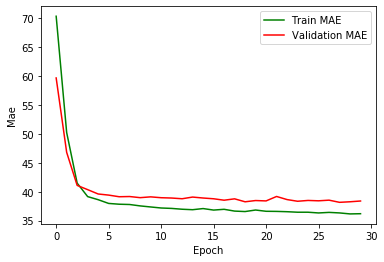

In [13]:
def plot_history(history):
  plt.figure(figsize = (6,4))
  
  plt.xlabel('Epoch')
  plt.ylabel('Mae')
  plt.plot(history.epoch, np.array(history.history['mae']),'g-',
           label='Train MAE')
  plt.plot(history.epoch, np.array(history.history['val_mae']),'r-',
           label = 'Validation MAE')
  plt.legend()
  plt.show()

plot_history(linreg_history)

def PlotResults(labels,predictions,binsize = 10):
  num_samples = len(labels)
  
  fig = plt.figure(figsize=(16,16))
  spec = gridspec.GridSpec(ncols=4, nrows=4, figure=fig)
  ax1 = fig.add_subplot(spec[0, :])
  ax2 = fig.add_subplot(spec[1, :])
  ax3 = fig.add_subplot(spec[2:,0:2])
  ax4 = fig.add_subplot(spec[2:,2:])
  
  ax1.plot(labels,'k-',label='Labels')
  ax1.plot(predictions,'r-',label='Predictions')
  ax1.set_ylabel('Pollution')
  ax1.legend()
  
  errors=np.absolute(labels-predictions)
  ax2.plot(errors,'k-')
  ax2.set_ylabel("Absolute error")
  
  ax3.scatter(labels,predictions)
  ax3.set_xlabel('Labels')
  ax3.set_ylabel('Predictions')

  bins = np.arange(0,(np.ceil(np.max(errors)/binsize)+1)*binsize,binsize)
  
  ax4.hist(errors,bins=bins)
  ax4.set_xlabel('Absolute error')
  ax4.set_ylabel('Frequency')

  plt.show()

"Current pollution" baseline:
 train mae =  34.301556 
 validation mae =  38.38618
(26274, 1)
(8754, 1)


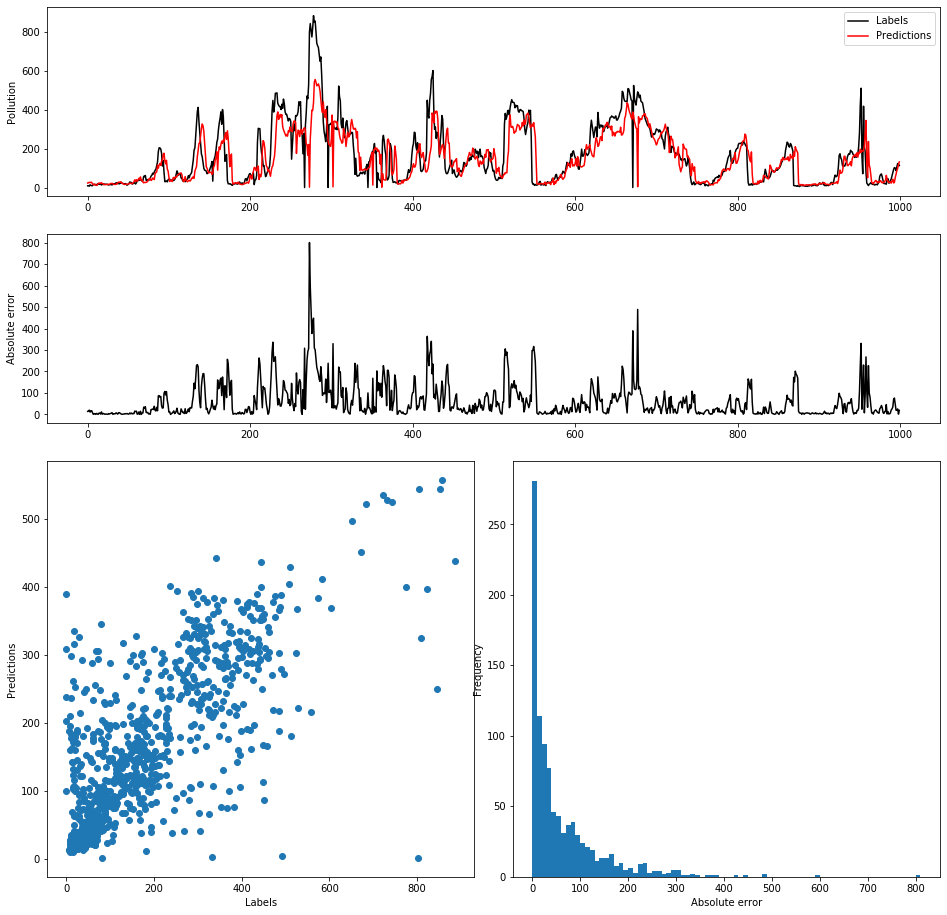

In [14]:
from sklearn.metrics import mean_absolute_error
import matplotlib.gridspec as gridspec

y_train_linreg = model.predict(X_train_d)
y_val_linreg = model.predict(X_val_d)

mae_train_linreg = mean_absolute_error(r_train_d,y_train_linreg)
mae_val_linreg = mean_absolute_error(r_val_d,y_val_linreg)

print("\"Current pollution\" baseline:\n train mae = ",mae_train_linreg,
      "\n validation mae = ",mae_val_linreg)

print(y_train_linreg.shape)
print(y_val_linreg.shape)

# Visualise first 1000 predictions for validation
PlotResults(r_val_d[:1000],y_val_linreg[:1000,0])


# Step 2

In [0]:
# window-based and recurrent networks:
# now, you use a window of k history values to predict
# this means that the features of the first k timesteps (indices 0 to k-1)
# are used to predict the k+6th pollution value (index k+6-1)
# output dimension of train data is samples x window x features

def create_dataset_windowed(train, test, ahead=6, window_size=1):
  samples = train.shape[0]-ahead-(window_size-1)
  dataX= []
  for i in range(samples):
      a = train[i:(i+window_size), :]
      dataX.append(a)
  return np.array(dataX), test[ahead+window_size-1:]

In [0]:
# current code for pollution-only, add other features for multi-feature model, 
# remove indices as in commented code if you want to use all features
train_features = [0,]

def create_data(CNN_WINDOW_SIZE=24):
  X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features],train_labels, window_size=CNN_WINDOW_SIZE)
  X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features],val_labels, window_size=CNN_WINDOW_SIZE)
  return X_train_w, r_train_w, X_val_w, r_val_w

def conv_model(CNN_WINDOW_SIZE=24,kernel_size=2):
  CNNmodel = Sequential()
  CNNmodel.add(Conv1D(input_shape = (CNN_WINDOW_SIZE, X_train_w.shape[-1]), 
                          filters=64,
                          kernel_size=(kernel_size,),
                          padding='same',
                          activation='relu',
                          kernel_initializer='he_uniform'))
  CNNmodel.add(Dropout(0.1))
  CNNmodel.add(BatchNormalization())
  CNNmodel.add(MaxPooling1D(pool_size=2))
  CNNmodel.add(Conv1D(filters=128,
                        kernel_size=(kernel_size,),
                        padding='same',
                        activation='relu',
                        kernel_initializer='he_uniform'))
  CNNmodel.add(Dropout(0.2))
  CNNmodel.add(BatchNormalization())
  CNNmodel.add(MaxPooling1D(pool_size=2))
  CNNmodel.add(Conv1D(filters=256,
                          kernel_size=(kernel_size,),
                          padding='same',
                          activation='relu',
                          kernel_initializer='he_uniform'))
  CNNmodel.add(Dropout(0.5))
  CNNmodel.add(BatchNormalization())
  CNNmodel.add(MaxPooling1D(pool_size=2))
  CNNmodel.add(Flatten())
  CNNmodel.add(Dense(1,kernel_initializer='glorot_uniform'))
  CNNmodel.add(Activation('linear'))
  return CNNmodel

In [20]:
# Apply trend removal
# Differentiate by subtracting current pollution value from future pollution value in labels
ahead = 6
batch_size=5*168 # 5 weeks
epochs=30

best_mae = 1000
best_window_size = 0
best_kernel_size = 0
learning_rate = 0.01
CNN_WINDOW_SIZES = np.arange(12,25,1)
kernel_sizes = np.arange(2,7,1)
CNN_history = 0
def create_trend_removed_data(CNN_WINDOW_SIZE=24):
  X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features],train_labels, window_size=CNN_WINDOW_SIZE)
  r_train_w = r_train_w-train_labels[CNN_WINDOW_SIZE-1:-ahead]
  X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features],val_labels, window_size=CNN_WINDOW_SIZE)
  r_val_w = r_val_w-val_labels[CNN_WINDOW_SIZE-1:-ahead]
  return X_train_w, r_train_w, X_val_w, r_val_w

for window_size in CNN_WINDOW_SIZES:
  for kernel_size in kernel_sizes:
    X_train_w, r_train_w, X_val_w, r_val_w = create_trend_removed_data(window_size)
    CNNmodel = conv_model(window_size,kernel_size)
    CNNmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),loss='mae', metrics=['mae'])
    CNN_history = CNNmodel.fit(X_train_w, r_train_w, 
              batch_size=batch_size,
              epochs=epochs,
              verbose=1,
              validation_data=(X_val_w, r_val_w),
              shuffle=True)
    y_val_CNNmodel = CNNmodel.predict(X_val_w)
    mae_val_CNNmodel = mean_absolute_error(r_val_w,y_val_CNNmodel)
    if best_mae > mae_val_CNNmodel:
      best_mae = mae_val_CNNmodel
      best_window_size = window_size
      best_kernel_size = kernel_size

print(f'Best window size: {best_window_size}. Best kernel size: {best_kernel_size}. MAE: {best_mae}')

if False:
  window_size = 24
  X_train_w, r_train_w, X_val_w, r_val_w = create_trend_removed_data(window_size)
  print(val_labels[window_size+100-1])
  print(val_labels[window_size+100-1+ahead])
  print(r_val_w[100])
  CNNmodel = conv_model(window_size)
  CNNmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),loss='mae', metrics=['mae'])
  if False:
    CNN_history = CNNmodel.fit(X_train_w, r_train_w, 
                              batch_size=batch_size,
                              epochs=epochs,
                              verbose=1,
                              validation_data=(X_val_w, r_val_w),
                              shuffle=True)

Train on 26263 samples, validate on 8743 samples
Epoch 1/30
26263/26263 [==============================] - 2s 62us/sample - loss: 38.1177 - mae: 38.1177 - val_loss: 46.1332 - val_mae: 46.1332
Epoch 2/30
26263/26263 [==============================] - 0s 18us/sample - loss: 37.6582 - mae: 37.6582 - val_loss: 42.1439 - val_mae: 42.1439
Epoch 3/30
26263/26263 [==============================] - 0s 19us/sample - loss: 37.5306 - mae: 37.5306 - val_loss: 41.8480 - val_mae: 41.8480
Epoch 4/30
26263/26263 [==============================] - 1s 19us/sample - loss: 37.4492 - mae: 37.4492 - val_loss: 41.6226 - val_mae: 41.6226
Epoch 5/30
26263/26263 [==============================] - 0s 19us/sample - loss: 37.4207 - mae: 37.4207 - val_loss: 41.5574 - val_mae: 41.5574
Epoch 6/30
26263/26263 [==============================] - 0s 19us/sample - loss: 37.3300 - mae: 37.3300 - val_loss: 41.8327 - val_mae: 41.8327
Epoch 7/30
26263/26263 [==============================] - 0s 19us/sample - loss: 37.2954 - ma

Train on 26253 samples, validate on 8733 samples
Epoch 1/30
26253/26253 [==============================] - 2s 64us/sample - loss: 38.0111 - mae: 38.0111 - val_loss: 48.0929 - val_mae: 48.0929
Epoch 2/30
26253/26253 [==============================] - 1s 26us/sample - loss: 37.2588 - mae: 37.2588 - val_loss: 42.2814 - val_mae: 42.2814
Epoch 3/30
26253/26253 [==============================] - 1s 26us/sample - loss: 36.9936 - mae: 36.9936 - val_loss: 41.4216 - val_mae: 41.4216
Epoch 4/30
26253/26253 [==============================] - 1s 25us/sample - loss: 36.7692 - mae: 36.7692 - val_loss: 41.3071 - val_mae: 41.3071
Epoch 5/30
26253/26253 [==============================] - 1s 25us/sample - loss: 36.6671 - mae: 36.6671 - val_loss: 41.3829 - val_mae: 41.3829
Epoch 6/30
26253/26253 [==============================] - 1s 26us/sample - loss: 36.4956 - mae: 36.4956 - val_loss: 41.7316 - val_mae: 41.7316
Epoch 7/30
26253/26253 [==============================] - 1s 26us/sample - loss: 36.3073 - ma

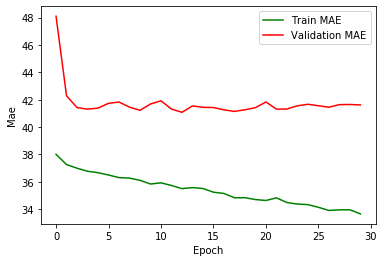

"Current pollution" CNN:
 train mae =  33.62797 
 validation mae =  41.61521
(26253, 1)
(8733, 1)


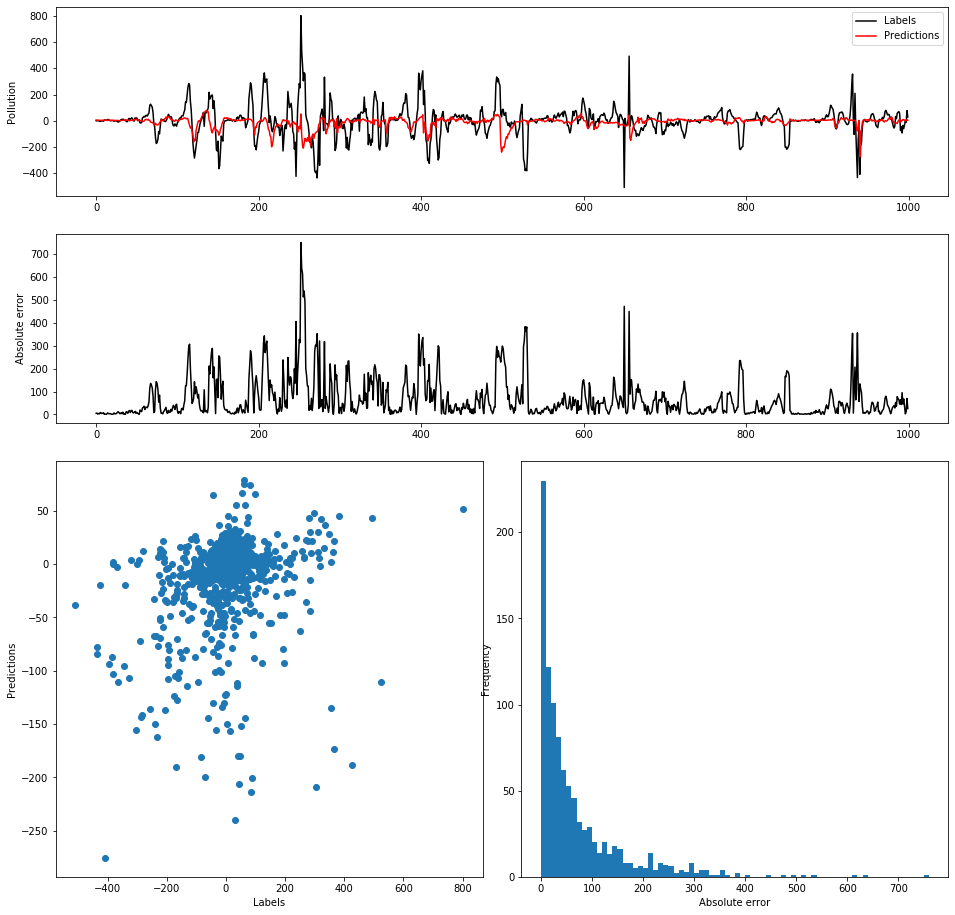

In [21]:
# Analyze best results
X_train_w, r_train_w, X_val_w, r_val_w = create_trend_removed_data(best_window_size)
CNNmodel = conv_model(best_window_size,best_kernel_size)
CNNmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),loss='mae', metrics=['mae'])
CNN_history = CNNmodel.fit(X_train_w, r_train_w, 
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(X_val_w, r_val_w),
          shuffle=True)

plot_history(CNN_history)

y_train_cnn = CNNmodel.predict(X_train_w)
y_val_cnn = CNNmodel.predict(X_val_w)

mae_train_cnn = mean_absolute_error(r_train_w,y_train_cnn)
mae_val_cnn = mean_absolute_error(r_val_w,y_val_cnn)

print("\"Current pollution\" CNN:\n train mae = ",mae_train_cnn,
      "\n validation mae = ",mae_val_cnn)

print(y_train_cnn.shape)
print(y_val_cnn.shape)

# Visualise first 1000 predictions for validation
PlotResults(r_val_w[:1000],y_val_cnn[:1000,0])

Train on 35013 samples
Epoch 1/30
35013/35013 [==============================] - 2s 51us/sample - loss: 38.7459 - mae: 38.7459
Epoch 2/30
35013/35013 [==============================] - 1s 23us/sample - loss: 38.1952 - mae: 38.1952
Epoch 3/30
35013/35013 [==============================] - 1s 24us/sample - loss: 37.8470 - mae: 37.8470
Epoch 4/30
35013/35013 [==============================] - 1s 24us/sample - loss: 37.7083 - mae: 37.7083
Epoch 5/30
35013/35013 [==============================] - 1s 23us/sample - loss: 37.5744 - mae: 37.5744
Epoch 6/30
35013/35013 [==============================] - 1s 23us/sample - loss: 37.4966 - mae: 37.4966
Epoch 7/30
35013/35013 [==============================] - 1s 23us/sample - loss: 37.4541 - mae: 37.4541
Epoch 8/30
35013/35013 [==============================] - 1s 23us/sample - loss: 37.2768 - mae: 37.2768
Epoch 9/30
35013/35013 [==============================] - 1s 23us/sample - loss: 37.2683 - mae: 37.2683
Epoch 10/30
35013/35013 [================

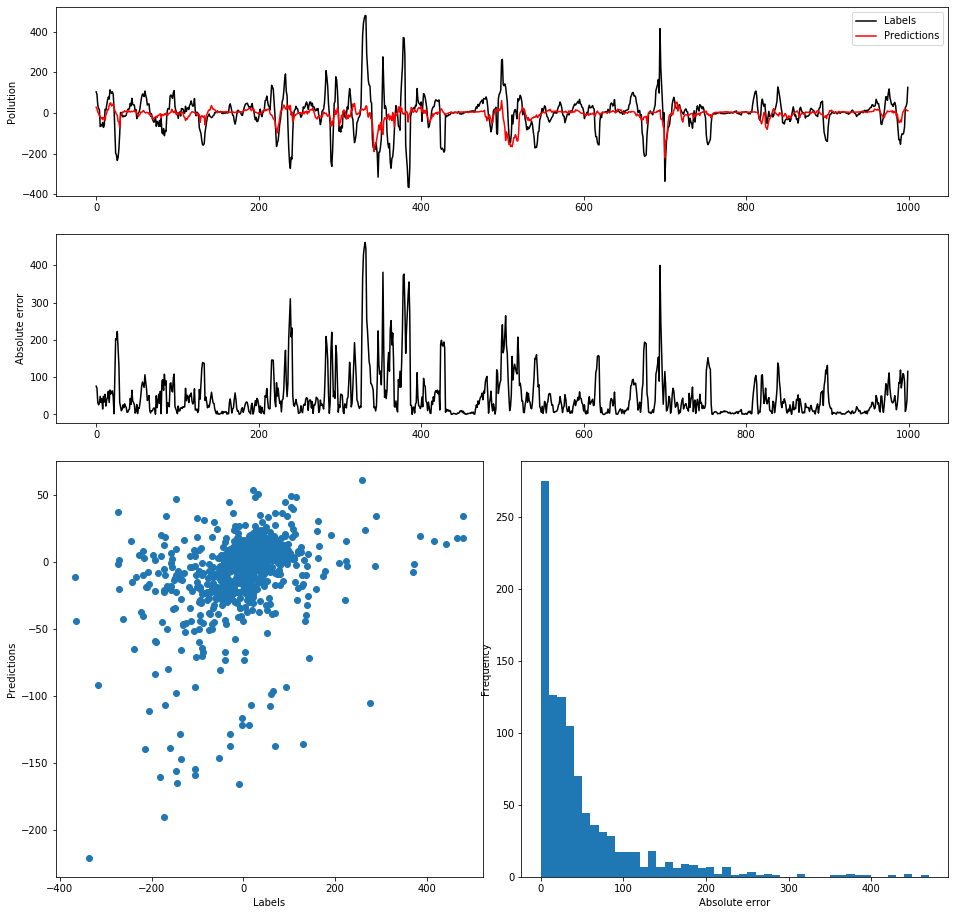

In [36]:
# Train on all data
def create_trend_removed_data_all(CNN_WINDOW_SIZE=24):
  X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels,window_size=CNN_WINDOW_SIZE)
  r_train_all_w = r_train_all_w-train_all_labels[CNN_WINDOW_SIZE-1:-ahead]
  X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels,window_size=CNN_WINDOW_SIZE)
  r_test_w = r_test_w-test_labels[CNN_WINDOW_SIZE-1:-ahead]
  return X_train_all_w,r_train_all_w,X_test_w,r_test_w

X_train_all_w,r_train_all_w,X_test_w,r_test_w = create_trend_removed_data_all(best_window_size)

CNNmodel = conv_model(best_window_size,best_kernel_size)
CNNmodel.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),loss='mae', metrics=['mae'])
CNN_history = CNNmodel.fit(X_train_all_w, r_train_all_w, 
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          shuffle=True)

#plot_history(CNN_history)

y_train_all_cnn = CNNmodel.predict(X_train_all_w)
y_test_cnn = CNNmodel.predict(X_test_w)

mae_train_all_cnn = mean_absolute_error(r_train_all_w,y_train_all_cnn)
mae_test_cnn = mean_absolute_error(r_test_w,y_test_cnn)

print("\"Current pollution\" CNN:\n train all mae = ",mae_train_all_cnn,
      "\n test mae = ",mae_test_cnn)

print(y_train_all_cnn.shape)
print(y_test_cnn.shape)

# Visualise first 1000 predictions for validation
PlotResults(r_test_w[:1000],y_test_cnn[:1000,0])

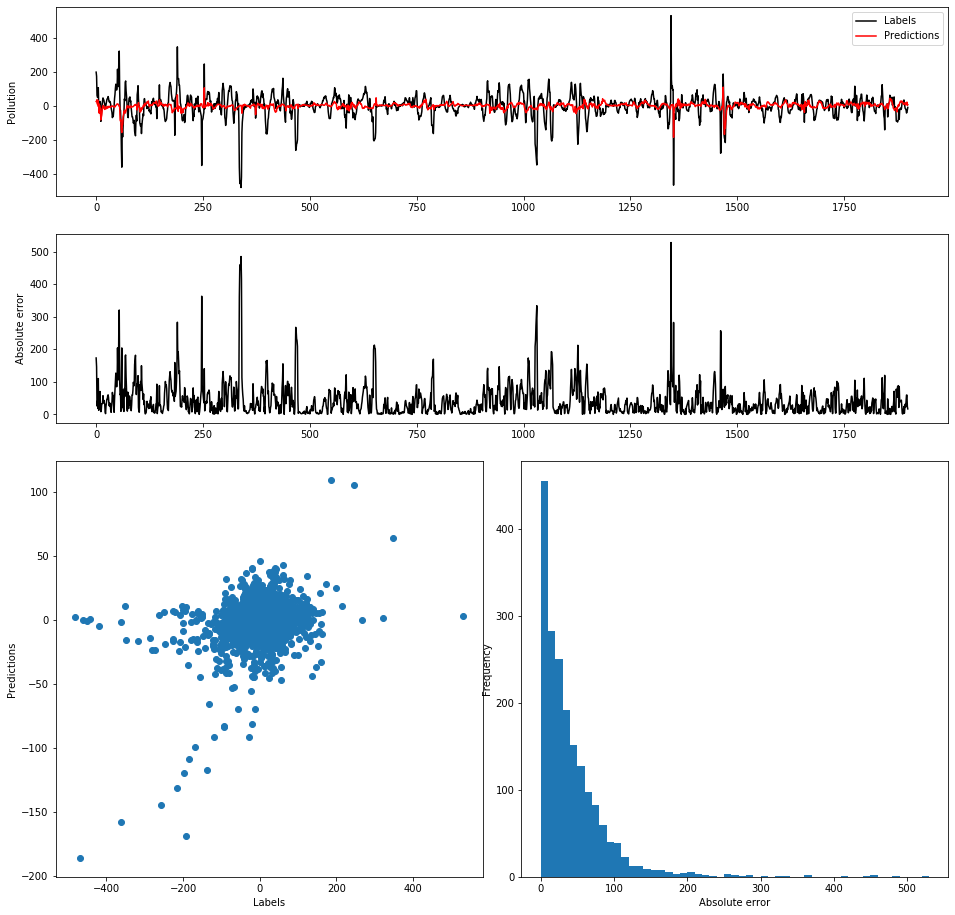

In [34]:
PlotResults(r_test_w[1000:2900],y_test_cnn[1000:2900,0])

# Step 3

# Step 4